In [31]:
import numpy as np
import soundfile as sf
from IPython.display import Audio
import matplotlib.pyplot as plt
from scipy.io.wavfile import write
from scipy.signal import find_peaks
from scipy.signal import spectrogram
from scipy.fftpack import fft

In [32]:
%matplotlib inline
plt.rcParams['font.family'] = 'monospace'
plt.rcParams['font.size'] = 12

In [34]:
# Constants
MIDIFROM = 24
MIDITO = 108
SKIP_SEC = 0.25
HOWMUCH_SEC = 0.5
WHOLETONE_SEC = 2
MY_TONE_1 = 30
MY_TONE_2 = 76
MY_TONE_3 = 107

## Základy

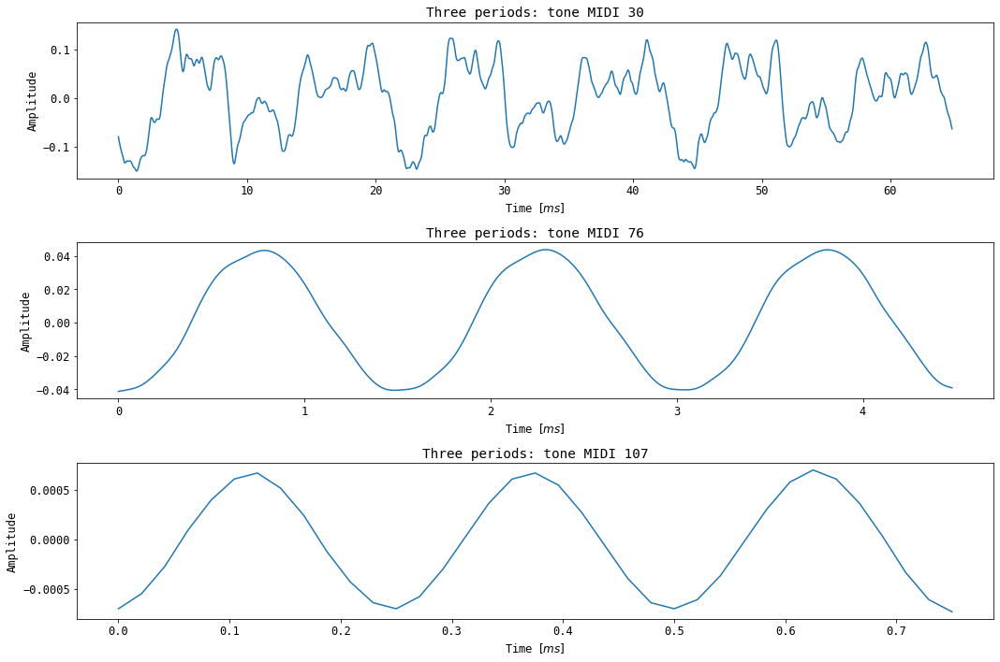

In [37]:
# Loading all tones
howmanytones = MIDITO - MIDIFROM + 1
tones = np.arange(MIDIFROM, MIDITO + 1)
s, Fs = sf.read('klavir.wav')
N = int(Fs * HOWMUCH_SEC)
Nwholetone = int(Fs * WHOLETONE_SEC)
xall = np.zeros((MIDITO + 1, N))
samplefrom = int(SKIP_SEC * Fs)
sampleto = samplefrom + N

for tone in tones:
    x = s[samplefrom:sampleto]
    x = x - np.mean(x)
    xall[tone,:] = x
    samplefrom += Nwholetone
    sampleto += Nwholetone

# Show 3 periods of my tones
tone1 = xall[MY_TONE_1]
period1 = int(1 / 46.25 * Fs)
time1 = np.arange(0, 3 * period1) / Fs * 1000
x1 = tone1[20100:20100 + 3 * period1]

tone2 = xall[MY_TONE_2]
period2 = int(1 / 659.26 * Fs)
time2 = np.arange(0, 3 * period2) / Fs * 1000
x2 = tone2[20040:20040 + 3 * period2]

tone3 = xall[MY_TONE_3]
period3 = int(1 / 3951.07 * Fs)
time3 = np.arange(0, 3 * period3 + 1) / Fs * 1000
x3 = tone3[20098:20098 + 3 * period3 + 1]

_, ax = plt.subplots(3,1, figsize=(15, 10))
ax[0].plot(time1, x1)
ax[0].set_title('Three periods: tone MIDI 30')
ax[0].set_ylabel('Amplitude')
ax[0].set_xlabel('Time $[ms]$')
ax[1].plot(time2, x2)
ax[1].set_title('Three periods: tone MIDI 76')
ax[1].set_ylabel('Amplitude')
ax[1].set_xlabel('Time $[ms]$')
ax[2].plot(time3, x3)
ax[2].set_title('Three periods: tone MIDI 107')
ax[2].set_ylabel('Amplitude')
ax[2].set_xlabel('Time $[ms]$')
plt.tight_layout()

#sf.write("audio/a_orig.wav", tone1, Fs)
#sf.write("audio/b_orig.wav", tone2, Fs)
#sf.write("audio/c_orig.wav", tone3, Fs)

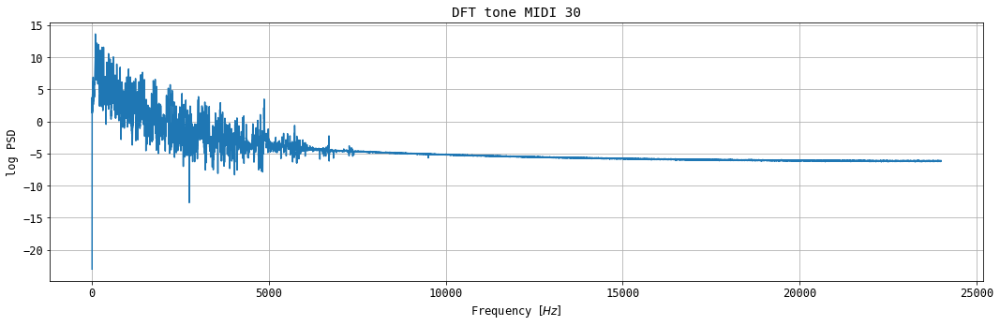

In [38]:
# DFT tone MIDI 30
X = np.fft.fft(tone1)
X[0] = X[0] + 0.00001
kall = np.arange(0, N // 2)
Xmag = np.log(np.abs(X[kall]) ** 2)
f = kall / N * Fs

plt.figure(figsize=(15,5))
plt.plot(f, Xmag)
plt.title('DFT tone MIDI 30')
plt.ylabel('log PSD')
plt.xlabel('Frequency $[Hz]$')
plt.grid()
plt.tight_layout()

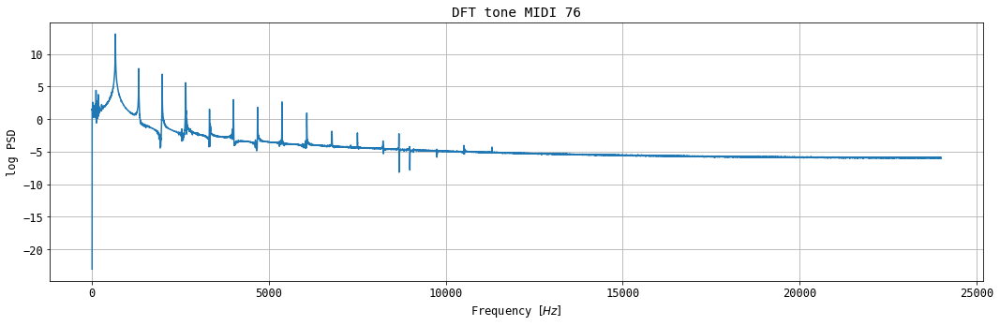

In [39]:
# DFT tone MIDI 76
Y = np.fft.fft(tone2)
Y[0] = Y[0] + 0.00001
kall = np.arange(0, N // 2)
Ymag = np.log(np.abs(Y[kall]) ** 2)
f = kall / N * Fs

plt.figure(figsize=(15,5))
plt.plot(f, Ymag)
plt.title('DFT tone MIDI 76')
plt.ylabel('log PSD')
plt.xlabel('Frequency $[Hz]$')
plt.grid()
plt.tight_layout()

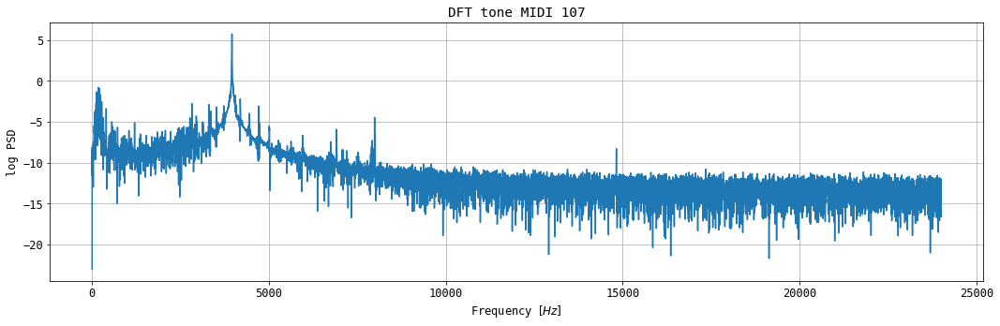

In [40]:
# DFT tone MIDI 107
Z = np.fft.fft(tone3)
Z[0] = Z[0] + 0.00001
kall = np.arange(0, N // 2)
Zmag = np.log(np.abs(Z[kall]) ** 2)
f = kall / N * Fs

plt.figure(figsize=(15,5))
plt.plot(f, Zmag)
plt.title('DFT tone MIDI 107')
plt.ylabel('log PSD')
plt.xlabel('Frequency $[Hz]$')
plt.grid()
plt.tight_layout()

## Určenie základnej frekvencie

In [41]:
print("Fundamental frequencies - DFT")
num = 0
dftff = np.zeros(109)
for tone in xall:
    if(num < 24):
        num = num + 1
        continue
    DFT = np.fft.fft(tone)
    kall = np.arange(0, N // 2)
    DFTmag = np.abs(DFT[kall])
    f = kall / N * Fs
    ff = np.round(f[DFTmag.argmax()], 2)
    print("MIDI " + str(num) + ": " + str(ff))
    dftff[num] = ff
    num = num + 1

Fundamental frequencies - DFT
MIDI 24: 66.0
MIDI 25: 70.0
MIDI 26: 74.0
MIDI 27: 78.0
MIDI 28: 82.0
MIDI 29: 88.0
MIDI 30: 92.0
MIDI 31: 98.0
MIDI 32: 104.0
MIDI 33: 110.0
MIDI 34: 116.0
MIDI 35: 124.0
MIDI 36: 130.0
MIDI 37: 138.0
MIDI 38: 220.0
MIDI 39: 234.0
MIDI 40: 248.0
MIDI 41: 88.0
MIDI 42: 92.0
MIDI 43: 98.0
MIDI 44: 104.0
MIDI 45: 110.0
MIDI 46: 118.0
MIDI 47: 124.0
MIDI 48: 130.0
MIDI 49: 138.0
MIDI 50: 146.0
MIDI 51: 156.0
MIDI 52: 164.0
MIDI 53: 350.0
MIDI 54: 370.0
MIDI 55: 392.0
MIDI 56: 208.0
MIDI 57: 220.0
MIDI 58: 234.0
MIDI 59: 248.0
MIDI 60: 262.0
MIDI 61: 278.0
MIDI 62: 294.0
MIDI 63: 312.0
MIDI 64: 330.0
MIDI 65: 350.0
MIDI 66: 370.0
MIDI 67: 392.0
MIDI 68: 416.0
MIDI 69: 440.0
MIDI 70: 466.0
MIDI 71: 494.0
MIDI 72: 524.0
MIDI 73: 554.0
MIDI 74: 588.0
MIDI 75: 622.0
MIDI 76: 660.0
MIDI 77: 698.0
MIDI 78: 740.0
MIDI 79: 784.0
MIDI 80: 830.0
MIDI 81: 882.0
MIDI 82: 932.0
MIDI 83: 988.0
MIDI 84: 1046.0
MIDI 85: 1108.0
MIDI 86: 1174.0
MIDI 87: 1244.0
MIDI 88: 1318.0
M

In [42]:
print("Fundamental frequencies - Autocorrelation")
num = 0
autoff = np.zeros(109)
for tone in xall:
    if(num < 24):
        num = num + 1
        continue
    acf = np.correlate(tone, tone, 'full')
    acf = acf[-len(tone):]
    peaks, _ = find_peaks(acf)
    index = acf[peaks].argmax()
    ff = np.round(1 / peaks[index] * Fs, 2)
    print("MIDI " + str(num) + ": " + str(ff))
    autoff[num] = ff
    num = num + 1

Fundamental frequencies - Autocorrelation
MIDI 24: 32.81
MIDI 25: 34.76
MIDI 26: 36.84
MIDI 27: 39.02
MIDI 28: 41.34
MIDI 29: 43.8
MIDI 30: 46.42
MIDI 31: 49.18
MIDI 32: 52.12
MIDI 33: 55.17
MIDI 34: 58.47
MIDI 35: 61.94
MIDI 36: 65.57
MIDI 37: 69.46
MIDI 38: 73.62
MIDI 39: 77.92
MIDI 40: 82.62
MIDI 41: 87.75
MIDI 42: 92.84
MIDI 43: 98.36
MIDI 44: 104.35
MIDI 45: 110.6
MIDI 46: 117.07
MIDI 47: 123.71
MIDI 48: 131.15
MIDI 49: 138.73
MIDI 50: 147.24
MIDI 51: 155.84
MIDI 52: 164.95
MIDI 53: 175.18
MIDI 54: 185.33
MIDI 55: 196.72
MIDI 56: 207.79
MIDI 57: 220.18
MIDI 58: 234.15
MIDI 59: 247.42
MIDI 60: 262.3
MIDI 61: 277.46
MIDI 62: 294.48
MIDI 63: 311.69
MIDI 64: 328.77
MIDI 65: 350.36
MIDI 66: 369.23
MIDI 67: 393.44
MIDI 68: 417.39
MIDI 69: 440.37
MIDI 70: 466.02
MIDI 71: 494.85
MIDI 72: 521.74
MIDI 73: 551.72
MIDI 74: 585.37
MIDI 75: 623.38
MIDI 76: 657.53
MIDI 77: 695.65
MIDI 78: 738.46
MIDI 79: 786.89
MIDI 80: 827.59
MIDI 81: 888.89
MIDI 82: 941.18
MIDI 83: 1000.0
MIDI 84: 1043.48
MIDI

In [43]:
# Fundamental frequencies of all tones
expectedff = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 32.70, 34.65, 36.71, 38.89, 41.20, 43.65,
              46.25, 49.00, 51.91, 55.00, 58.27, 61.74, 65.41, 69.30, 73.42, 77.78, 82.41, 87.31, 92.50, 98.00, 103.83, 110.00,
              116.54, 123.47, 130.81, 138.59,146.83, 155.56, 164.81, 174.61, 185.00, 196.00, 207.65, 220.00, 233.08, 246.94,
              261.63, 277.18, 293.66, 311.13, 329.63, 349.23, 369.99, 392.00, 415.30, 440.00, 466.16, 493.88, 523.25, 554.37,
              587.33, 622.25, 659.26, 698.46, 739.99, 783.99, 830.61, 880.00, 932.33, 987.77, 1046.50, 1108.73, 1174.66,
              1244.51, 1318.51, 1396.91, 1479.98, 1567.98, 1661.22, 1760.00, 1864.66, 1975.53, 2093.00, 2217.46, 2349.32,
              2489.02, 2637.02, 2793.83, 2959.96, 3135.96, 3322.44, 3520.00, 3729.31, 3951.07, 4186.01]
ffall = np.zeros(109)
for i in range(109):
    autodif = np.abs(expectedff[i] - autoff[i])
    dftdif = np.abs(expectedff[i] - dftff[i])
    if autodif < dftdif:
        ffall[i] = autoff[i]
    else:
        ffall[i] = dftff[i]
print(ffall)

[   0.      0.      0.      0.      0.      0.      0.      0.      0.
    0.      0.      0.      0.      0.      0.      0.      0.      0.
    0.      0.      0.      0.      0.      0.     32.81   34.76   36.84
   39.02   41.34   43.8    46.42   49.18   52.12   55.17   58.47   61.94
   65.57   69.46   73.62   77.92   82.62   87.75   92.84   98.    104.
  110.    117.07  123.71  131.15  138.73  147.24  155.84  164.95  175.18
  185.33  196.72  207.79  220.    234.    247.42  262.    277.46  294.
  311.69  330.    350.    370.    392.    416.    440.    466.02  494.
  524.    554.    588.    622.    660.    698.    740.    784.    830.
  882.    932.    988.   1046.   1108.   1174.   1244.   1318.   1396.
 1478.   1566.   1660.   1758.   1864.   1976.   2094.   2218.   2350.
 2490.   2638.   2796.   2962.   3138.   3324.   3522.   3732.   3954.
 4188.  ]


Expected fundamental frequency: 46.25
DFT: 92.0
Autocorrelation: 46.42


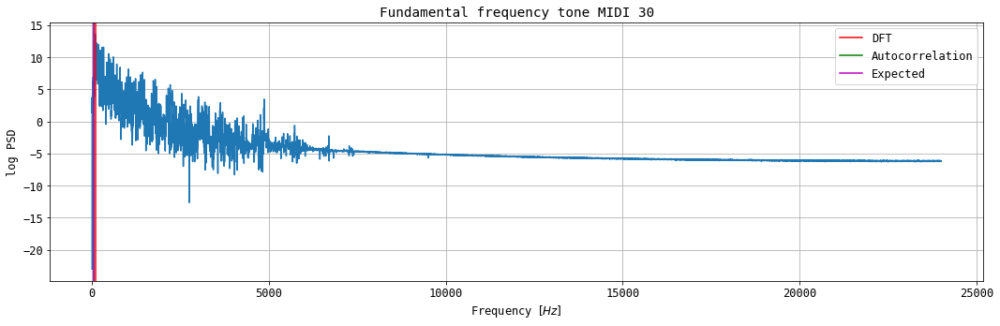

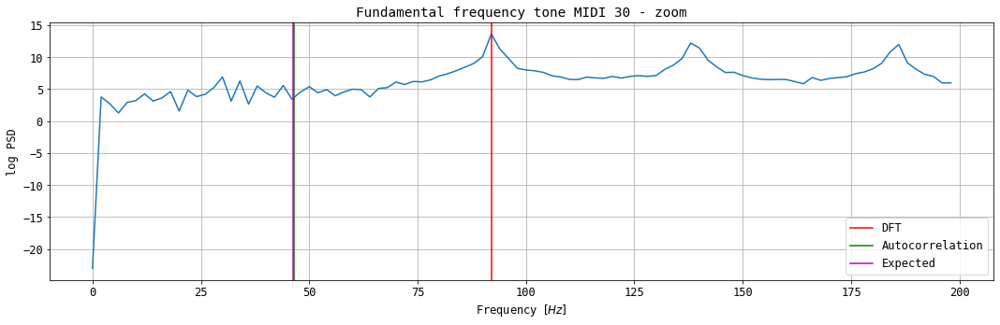

In [44]:
# Fundamental frequency tone MIDI 30
print('Expected fundamental frequency: 46.25')

acf = np.correlate(tone1, tone1, 'full')
acf = acf[-len(tone1):]
peaks, _ = find_peaks(acf)
index = acf[peaks].argmax()
XAutoff = np.round(1 / peaks[index] * Fs, 2)

XDFTff = np.round(f[Xmag.argmax()], 2)

print('DFT: ' + str(XDFTff))
print('Autocorrelation: ' + str(XAutoff))

plt.figure(figsize=(15,5))
plt.plot(f, Xmag)
plt.axvline(x = XDFTff, color = 'r', label='DFT')
plt.axvline(x = XAutoff, color = 'g', label='Autocorrelation')
plt.axvline(x = 46.25, color = 'm', label='Expected')
plt.title('Fundamental frequency tone MIDI 30')
plt.ylabel('log PSD')
plt.xlabel('Frequency $[Hz]$')
plt.grid()
plt.legend()
plt.tight_layout()

plt.figure(figsize=(15,5))
plt.plot(f[0:100], Xmag[0:100])
plt.axvline(x = XDFTff, color = 'r', label='DFT')
plt.axvline(x = XAutoff, color = 'g', label='Autocorrelation')
plt.axvline(x = 46.25, color = 'm', label='Expected')
plt.title('Fundamental frequency tone MIDI 30 - zoom')
plt.ylabel('log PSD')
plt.xlabel('Frequency $[Hz]$')
plt.grid()
plt.legend(loc='lower right')
plt.tight_layout()

Expected fundamental frequency: 659.26
DFT: 660.0
Autocorrelation: 657.53


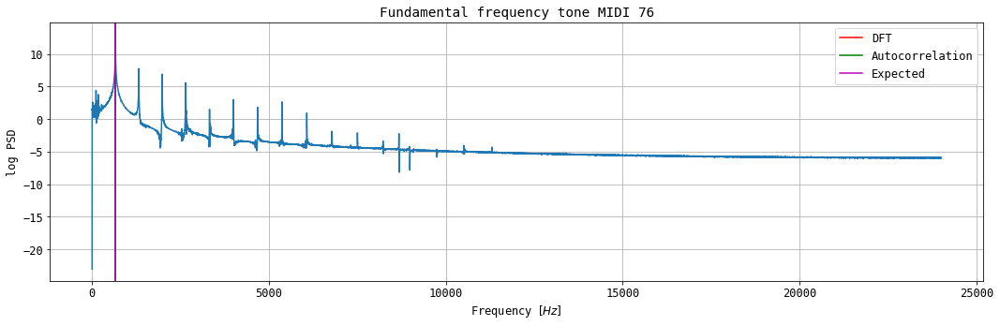

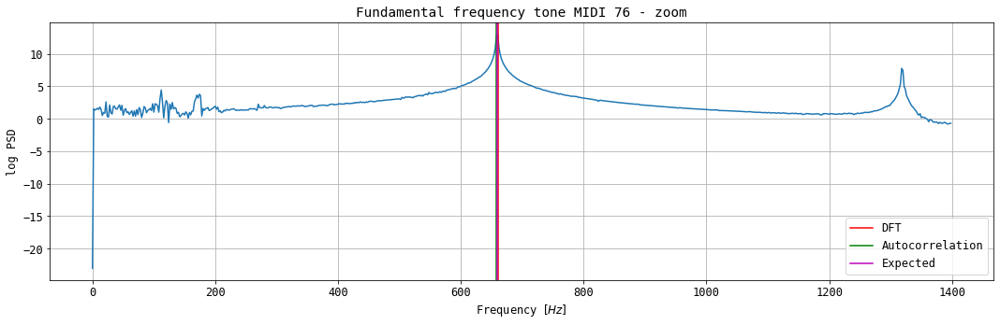

In [45]:
# Fundamental frequency tone MIDI 76
print('Expected fundamental frequency: 659.26')

acf = np.correlate(tone2, tone2, 'full')
acf = acf[-len(tone2):]
peaks, _ = find_peaks(acf)
index = acf[peaks].argmax()
YAutoff = np.round(1 / peaks[index] * Fs, 2)

YDFTff = np.round(f[Ymag.argmax()], 2)

print('DFT: ' + str(YDFTff))
print('Autocorrelation: ' + str(YAutoff))

plt.figure(figsize=(15,5))
plt.plot(f, Ymag)
plt.axvline(x = YDFTff, color = 'r', label='DFT')
plt.axvline(x = YAutoff, color = 'g', label='Autocorrelation')
plt.axvline(x = 659.26, color = 'm', label='Expected')
plt.title('Fundamental frequency tone MIDI 76')
plt.ylabel('log PSD')
plt.xlabel('Frequency $[Hz]$')
plt.grid()
plt.legend()
plt.tight_layout()

plt.figure(figsize=(15,5))
plt.plot(f[0:700], Ymag[0:700])
plt.axvline(x = YDFTff, color = 'r', label='DFT')
plt.axvline(x = YAutoff, color = 'g', label='Autocorrelation')
plt.axvline(x = 659.26, color = 'm', label='Expected')
plt.title('Fundamental frequency tone MIDI 76 - zoom')
plt.ylabel('log PSD')
plt.xlabel('Frequency $[Hz]$')
plt.grid()
plt.legend(loc='lower right')
plt.tight_layout()

Expected fundamental frequency: 3951.07
DFT: 3954.0
Autocorrelation: 4000.0


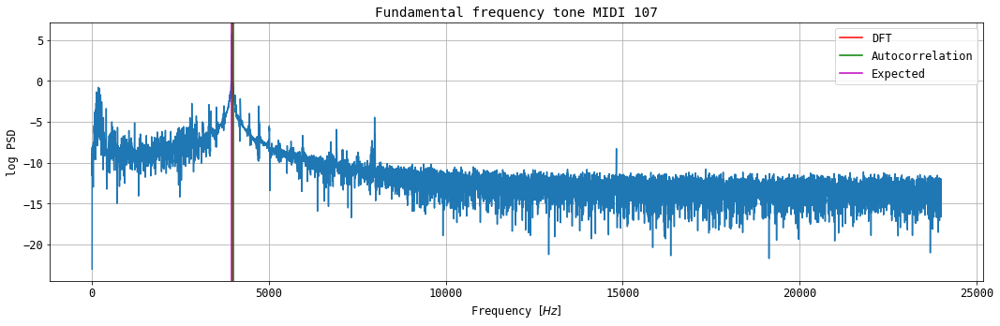

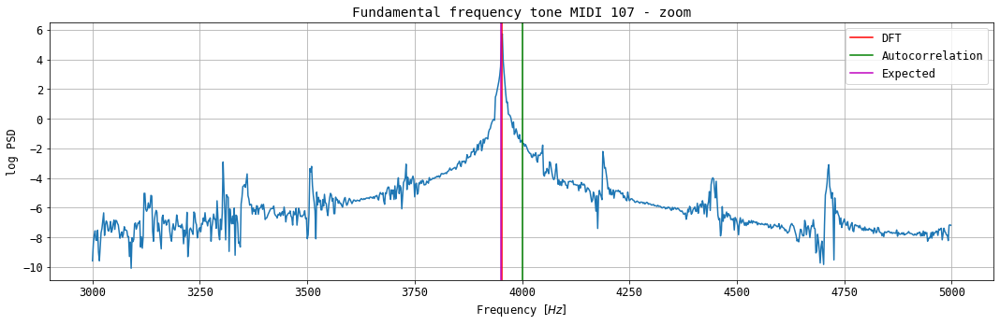

In [46]:
# Fundamental frequency tone MIDI 107
print('Expected fundamental frequency: 3951.07')

acf = np.correlate(tone3, tone3, 'full')
acf = acf[-len(tone3):]
peaks, _ = find_peaks(acf)
index = acf[peaks].argmax()
ZAutoff = np.round(1 / peaks[index] * Fs, 2)

ZDFTff = np.round(f[Zmag.argmax()], 2)

print('DFT: ' + str(ZDFTff))
print('Autocorrelation: ' + str(ZAutoff))

plt.figure(figsize=(15,5))
plt.plot(f, Zmag)
plt.axvline(x = ZDFTff, color = 'r', label='DFT')
plt.axvline(x = ZAutoff, color = 'g', label='Autocorrelation')
plt.axvline(x = 3951.07, color = 'm', label='Expected')
plt.title('Fundamental frequency tone MIDI 107')
plt.ylabel('log PSD')
plt.xlabel('Frequency $[Hz]$')
plt.grid()
plt.legend()
plt.tight_layout()

plt.figure(figsize=(15,5))
plt.plot(f[1500:2500], Zmag[1500:2500])
plt.axvline(x = ZDFTff, color = 'r', label='DFT')
plt.axvline(x = ZAutoff, color = 'g', label='Autocorrelation')
plt.axvline(x = 3951.07, color = 'm', label='Expected')
plt.title('Fundamental frequency tone MIDI 107 - zoom')
plt.ylabel('log PSD')
plt.xlabel('Frequency $[Hz]$')
plt.grid()
plt.legend()
plt.tight_layout()

## Spresnenie odhadu základnej frekvencie $f_0$

In [47]:
# Precise fundamental frequency - DTFT
RANGE = 2
FREQPOINTS = 100

for i in range(109):
    if i < 24:
        continue
    
    fmax = ffall[i]
    ffrom = fmax - RANGE
    fto = fmax + RANGE
    fsweep = np.linspace(ffrom, fto, FREQPOINTS)
    n = np.arange(0, N)
    A = np.zeros([FREQPOINTS, N], dtype=complex)
    for k in np.arange(0, FREQPOINTS):
        A[k,:] = np.exp(-1j * 2 * np.pi * fsweep[k] / Fs * n)
    dtft = np.matmul(A, xall[i].T)
    precisefmax = fsweep[np.argmax(np.log(np.abs(dtft) ** 2))]
    
    origdif = np.abs(expectedff[i] - fmax)
    newdif = np.abs(expectedff[i] - precisefmax)
    
    if origdif < newdif:
        ffall[i] = fmax
    else:
        ffall[i] = np.round(precisefmax, 2)

print(ffall)

[   0.      0.      0.      0.      0.      0.      0.      0.      0.
    0.      0.      0.      0.      0.      0.      0.      0.      0.
    0.      0.      0.      0.      0.      0.     32.81   34.76   36.84
   39.02   41.34   43.8    46.42   49.18   52.12   55.17   58.47   61.94
   65.35   69.46   73.62   77.92   82.62   87.69   92.84   98.    104.
  110.    117.07  123.71  130.52  138.73  146.69  155.38  164.95  174.51
  184.91  195.89  207.79  220.    233.25  247.08  261.78  277.32  293.62
  311.1   329.58  349.13  370.    392.    415.45  440.    466.28  493.82
  523.17  554.3   587.17  622.1   659.09  698.    740.    784.    830.
  881.66  932.    987.62 1046.14 1108.3  1174.22 1244.1  1318.18 1396.
 1478.95 1566.91 1660.06 1758.95 1864.   1976.   2093.98 2218.   2350.
 2490.   2638.   2795.05 2961.25 3137.37 3324.   3521.7  3731.13 3953.17
 4188.  ]


Original: 660.0
Precise: 659.09
Expected: 659.26


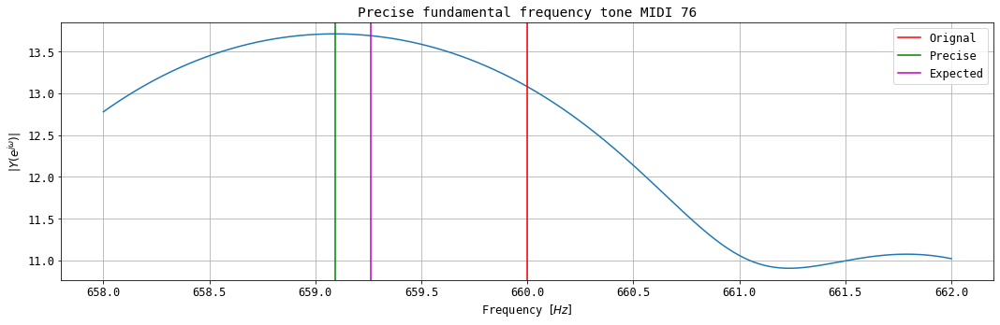

In [48]:
# Precise fundamental frequency tone MIDI 76 - DTFT
RANGE = 2
FREQPOINTS = 400
fmax = YDFTff
maxv = max(Ymag)
ffrom = fmax - RANGE
fto = fmax + RANGE
fsweep = np.linspace(ffrom, fto, FREQPOINTS)

n = np.arange(0, N)
A = np.zeros([FREQPOINTS, N], dtype=complex)
for k in np.arange(0, FREQPOINTS):
    A[k,:] = np.exp(-1j * 2 * np.pi * fsweep[k] / Fs * n)
Ydtft = np.matmul(A, tone2.T)

precisefmax = fsweep[np.argmax(np.log(np.abs(Ydtft) ** 2))]
plt.figure(figsize=(15, 5))
plt.plot(fsweep, np.log(np.abs(Ydtft) ** 2))
plt.axvline(x = fmax, color = 'r', label='Orignal')
plt.axvline(x = precisefmax, color = 'g', label='Precise')
plt.axvline(x = 659.26, color = 'm', label='Expected')
plt.title('Precise fundamental frequency tone MIDI 76')
plt.xlabel('Frequency $[Hz]$')
plt.ylabel('$|Y(e^{j\omega})|$')
plt.legend()
plt.grid()
plt.tight_layout()

print("Original:", fmax)
print("Precise:", np.round(precisefmax, 2))
print("Expected: 659.26")

## Reprezentácia klavíra

In [50]:
def representation_by_floats(tonenum):
    kall = np.arange(0, 11 * np.round(ffall[tonenum]))
    f = kall / N * Fs

    RANGE = 7
    FREQPOINTS = 100
    array = np.zeros(10)
    precisefmax = 0
    step = ffall[tonenum]
    
    for i in range(5):
        fmax = precisefmax + step
        ffrom = fmax - RANGE
        fto = fmax + RANGE
        fsweep = np.linspace(ffrom, fto, FREQPOINTS)
        
        n = np.arange(0, N)
        A = np.zeros([FREQPOINTS, N], dtype=complex)
        for k in np.arange(0, FREQPOINTS):
            A[k,:] = np.exp(-1j * 2 * np.pi * fsweep[k] / Fs * n)
        dtft = np.matmul(A, xall[tonenum].T)
        moddtft = np.log(np.abs(dtft)**2)
        
        before = precisefmax
        precisefmax = fsweep[np.argmax(moddtft)]
        step = precisefmax - before
        
        index = np.where(moddtft == max(moddtft))
        index = index[0]
        
        array[2 * i] = np.abs(dtft[index])
        array[2 * i + 1] = np.angle(dtft[index])
    
    return array

In [51]:
tones_floats = np.zeros((109, 10))

for i in range(109):
    if i < 24:
        continue
    tones_floats[i] = representation_by_floats(i)

print(tones_floats)

[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]
 ...
 [ 2.01122051e+01 -1.52483176e+00  4.06143814e-02 ...  2.19437773e+00
   2.87239087e-03  1.74173581e+00]
 [ 2.19247864e+01  1.91435698e+00  2.59953547e-02 ...  8.22757105e-01
   2.73581315e-03 -2.21086236e+00]
 [ 1.91880809e+01  5.37432424e-01  2.64925268e-02 ... -1.77542330e-01
   4.47700193e-03 -3.06202944e-01]]


Magnitude: [19.15723167]
Phase: [-0.21030115]
Magnitude: [944.47009906]
Phase: [-1.30885468]
Magnitude: [579.08871464]
Phase: [1.02772675]
Magnitude: [485.66724806]
Phase: [-2.33599891]
Magnitude: [297.54434326]
Phase: [2.83816785]


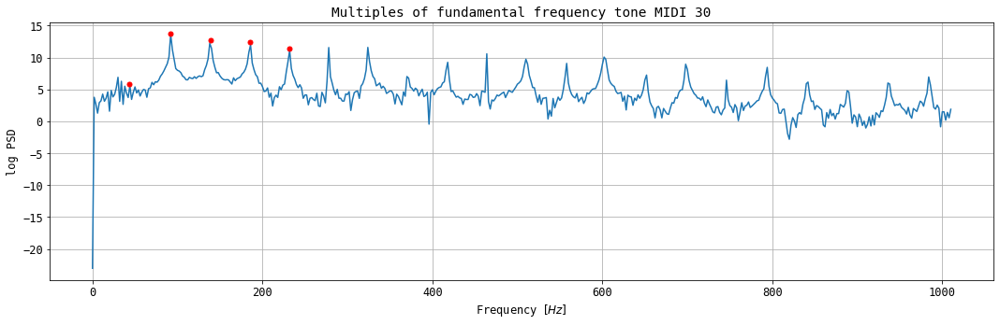

In [52]:
# Five fundamental frequencies tone MIDI 30
kall = np.arange(0, 11 * np.round(ffall[30]))
f = kall / N * Fs
plt.figure(figsize=(15,5))
plt.plot(f, Xmag[0: int(11 * np.round(ffall[30]))])
plt.title('Multiples of fundamental frequency tone MIDI 30')
plt.ylabel('log PSD')
plt.xlabel('Frequency $[Hz]$')
plt.grid()
plt.tight_layout()

RANGE = 5
FREQPOINTS = 100

precisefmax = 0
step = ffall[30]
for i in range(5):
    fmax = precisefmax + step
    ffrom = fmax - RANGE
    fto = fmax + RANGE
    fsweep = np.linspace(ffrom, fto, FREQPOINTS)
    
    n = np.arange(0, N)
    A = np.zeros([FREQPOINTS, N], dtype=complex)
    for k in np.arange(0, FREQPOINTS):
        A[k,:] = np.exp(-1j * 2 * np.pi * fsweep[k] / Fs * n)
    dtft = np.matmul(A, tone1.T)
    moddtft = np.log(np.abs(dtft) ** 2)
    
    before = precisefmax
    precisefmax = fsweep[np.argmax(moddtft)]
    step = precisefmax - before
    
    index = np.where(moddtft == max(moddtft))
    index = index[0]
    
    print("Magnitude:", np.abs(dtft[index]))
    print("Phase:", np.angle(dtft[index]))
    plt.plot(fsweep[index], moddtft[index], ".r", markersize=10)

Magnitude: [946.82946232]
Phase: [2.0044078]
Magnitude: [51.20885346]
Phase: [-1.12608956]
Magnitude: [31.47660066]
Phase: [3.04431453]
Magnitude: [23.3225494]
Phase: [-2.50684574]
Magnitude: [2.27773446]
Phase: [-2.94209496]


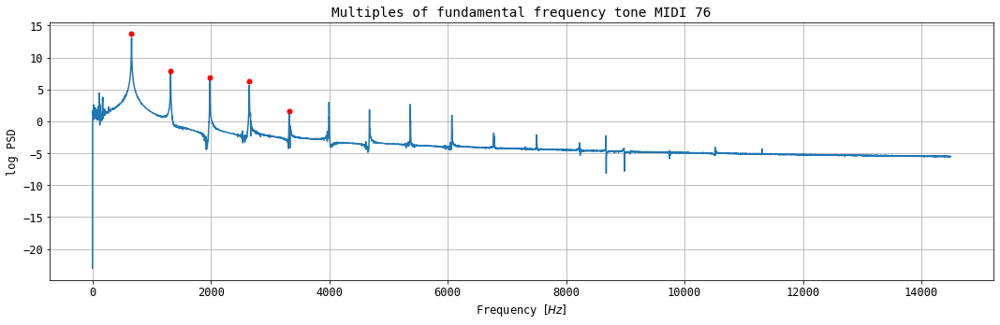

In [53]:
# Five fundamental frequencies tone MIDI 76
kall = np.arange(0, 11 * np.round(ffall[76]))
f = kall / N * Fs

plt.figure(figsize=(15,5))
plt.plot(f, Ymag[0: int(11 * np.round(ffall[76]))])
plt.title('Multiples of fundamental frequency tone MIDI 76')
plt.ylabel('log PSD')
plt.xlabel('Frequency $[Hz]$')
plt.grid()
plt.tight_layout()

RANGE = 7
FREQPOINTS = 100

precisefmax = 0
step = ffall[76]
for i in range(5):
    fmax = precisefmax + step
    ffrom = fmax - RANGE
    fto = fmax + RANGE
    fsweep = np.linspace(ffrom, fto, FREQPOINTS)
    
    n = np.arange(0, N)
    A = np.zeros([FREQPOINTS, N], dtype=complex)
    for k in np.arange(0, FREQPOINTS):
        A[k,:] = np.exp(-1j * 2 * np.pi * fsweep[k] / Fs * n)
    dtft = np.matmul(A, tone2.T)
    moddtft = np.log(np.abs(dtft) ** 2)
    
    before = precisefmax
    precisefmax = fsweep[np.argmax(moddtft)]
    step = precisefmax - before
    
    index = np.where(moddtft == max(moddtft))
    index = index[0]
    
    print("Magnitude:", np.abs(dtft[index]))
    print("Phase:", np.angle(dtft[index]))
    plt.plot(fsweep[index], moddtft[index], ".r", markersize=10)

Magnitude: [21.92478645]
Phase: [1.91435698]
Magnitude: [0.02599535]
Phase: [2.84934608]
Magnitude: [0.00366709]
Phase: [0.94147413]
Magnitude: [0.00324897]
Phase: [0.82275711]
Magnitude: [0.00273581]
Phase: [-2.21086236]


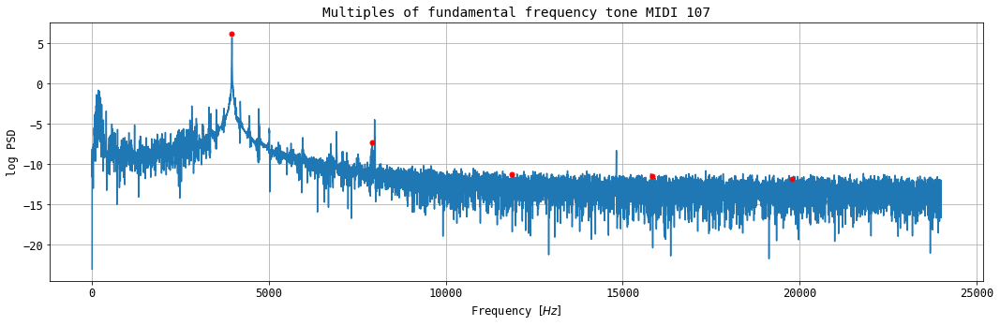

In [54]:
# Five fundamental frequencies tone MIDI 107
kall = np.arange(0, N // 2)
f = kall / N * Fs

plt.figure(figsize=(15,5))
plt.plot(f, Zmag)
plt.title('Multiples of fundamental frequency tone MIDI 107')
plt.ylabel('log PSD')
plt.xlabel('Frequency $[Hz]$')
plt.grid()
plt.tight_layout()

RANGE = 7
FREQPOINTS = 100

precisefmax = 0
step = ffall[107]
for i in range(5):
    fmax = precisefmax + step
    ffrom = fmax - RANGE
    fto = fmax + RANGE
    fsweep = np.linspace(ffrom, fto, FREQPOINTS)
    
    n = np.arange(0, N)
    A = np.zeros([FREQPOINTS, N], dtype=complex)
    for k in np.arange(0, FREQPOINTS):
        A[k,:] = np.exp(-1j * 2 * np.pi * fsweep[k] / Fs * n)
    dtft = np.matmul(A, tone3.T)
    moddtft = np.log(np.abs(dtft) ** 2)
    
    before = precisefmax
    precisefmax = fsweep[np.argmax(moddtft)]
    step = precisefmax - before
    
    index = np.where(moddtft == max(moddtft))
    index = index[0]
    
    print("Magnitude:", np.abs(dtft[index]))
    print("Phase:", np.angle(dtft[index]))
    plt.plot(fsweep[index], moddtft[index], ".r", markersize=10)

## Syntéza tónov

In [55]:
def tone_synthesis(tonenum, t1, t2, volume, Fs):
    t1 = int(t1 / 1000 * Fs)
    t2 = int(t2 / 1000 * Fs)
    T1 = 1 / ffall[tonenum] * Fs
    om1 = 2 * np.pi / T1
    t = np.linspace(t1, t2, t2 - t1)
    cos = np.zeros((5, t2 - t1))

    for i in range(5):
        magnitude = tones_floats[tonenum][2 * i]
        phase = tones_floats[tonenum][2 * i + 1]
        cos[i] = magnitude * np.cos((i + 1) * om1 * t + phase)
        
    tone_synth = cos[0] + cos[1] + cos[2] + cos[3] + cos[4]
    tone_synth = tone_synth / max(tone_synth) * volume / 100 * max(xall[tonenum])
    
    length = t2 - t1
    
    atime = int(length * 0.2)
    attack = np.linspace(0.01, 1, atime)
    tone_synth[:atime] *= attack
    
    dtime = int(length * 0.2)
    decay = np.linspace(1, 0.7, dtime)
    tone_synth[atime:atime + dtime] *= decay

    stime = int(length * 0.4)
    sustain = np.linspace(0.7, 0.7, stime)
    tone_synth[atime + dtime:atime + dtime + stime] *= sustain

    rtime = int(length * 0.2)
    release = np.linspace(0.7, 0.01, rtime)
    tone_synth[length - rtime:] *= release
    
    return tone_synth

In [82]:
# 1 second of my synthesized tones
a = tone_synthesis(30, 0, 1000, 100, 48000)
b = tone_synthesis(76, 0, 1000, 100, 48000)
c = tone_synthesis(107, 0, 1000, 100, 48000)

display(Audio(xall[30], rate=Fs))
display(Audio(a, rate=Fs))

display(Audio(xall[76], rate=Fs))
display(Audio(b, rate=Fs))

display(Audio(xall[107], rate=Fs))
display(Audio(c, rate=Fs))

#sf.write("audio/a.wav", a, Fs)
#sf.write("audio/b.wav", b, Fs)
#sf.write("audio/c.wav", c, Fs)

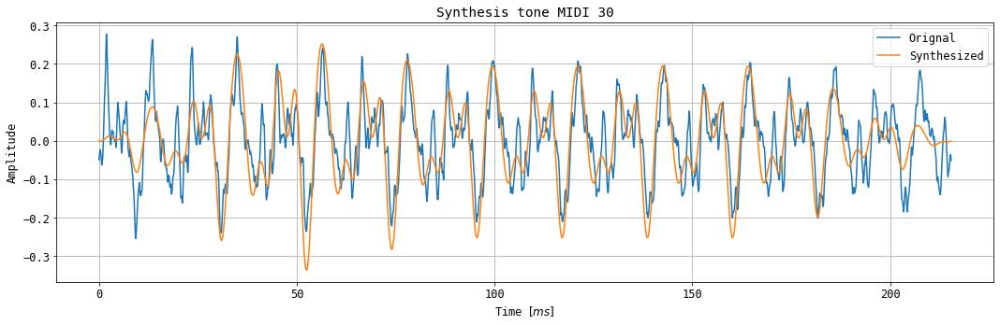

In [58]:
# Synthesis tone MIDI 30
T1 = 1 / ffall[30] * Fs
ten_periods = 10 * int(np.round(T1))
tone_synth = tone_synthesis(30, 0, ten_periods / Fs * 1000, 100, 48000)
time = np.arange(0, ten_periods) / Fs * 1000

plt.figure(figsize=(15, 5))
plt.plot(time, tone1[:ten_periods], label='Orignal')
plt.plot(time, tone_synth, label='Synthesized')
plt.title('Synthesis tone MIDI 30')
plt.ylabel('Amplitude')
plt.xlabel('Time $[ms]$')
plt.grid()
plt.legend()
plt.tight_layout()

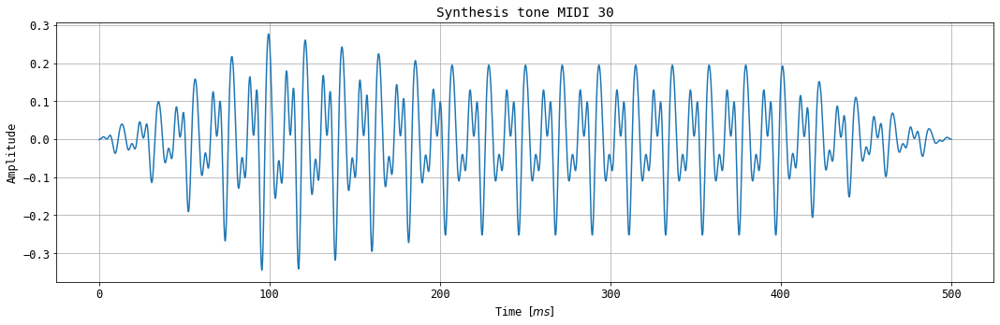

In [59]:
# Synthesis tone MIDI 30 whole

tone_synth = tone_synthesis(30, 0, 500, 100, 48000)
time = np.arange(0, tone_synth.size) / Fs * 1000

plt.figure(figsize=(15, 5))
plt.plot(time, tone_synth)
plt.title('Synthesis tone MIDI 30')
plt.ylabel('Amplitude')
plt.xlabel('Time $[ms]$')
plt.grid()
plt.tight_layout()

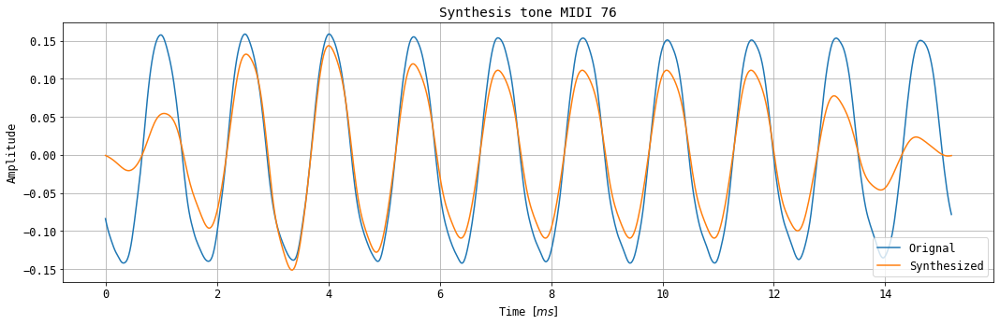

In [60]:
# Synthesis tone MIDI 76
T1 = 1 / ffall[76] * Fs
ten_periods = 10 * int(np.round(T1))
tone_synth = tone_synthesis(76, 0, ten_periods / Fs * 1000, 100, 48000)
time = np.arange(0, ten_periods) / Fs * 1000

plt.figure(figsize=(15, 5))
plt.plot(time, tone2[:ten_periods], label='Orignal')
plt.plot(time, tone_synth[:ten_periods], label='Synthesized')
plt.title('Synthesis tone MIDI 76')
plt.ylabel('Amplitude')
plt.xlabel('Time $[ms]$')
plt.grid()
plt.legend()
plt.tight_layout()

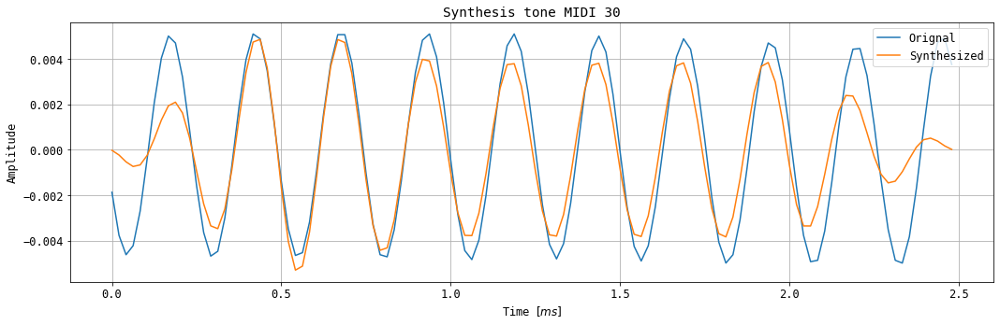

In [61]:
# Synthesis tone MIDI 107
T1 = 1 / ffall[107] * Fs
ten_periods = 10 * int(np.round(T1))
tone_synth = tone_synthesis(107, 0, ten_periods / Fs * 1000, 100, 48000)
time = np.arange(0, ten_periods) / Fs * 1000

plt.figure(figsize=(15, 5))
plt.plot(time, tone3[:ten_periods], label='Orignal')
plt.plot(time, tone_synth[:ten_periods], label='Synthesized')
plt.title('Synthesis tone MIDI 30')
plt.ylabel('Amplitude')
plt.xlabel('Time $[ms]$')
plt.grid()
plt.legend(loc='upper right')
plt.tight_layout()

## Generovanie hudby

In [81]:
def generate_music(song, Fs):
    music = np.zeros(0)
    
    f = open(song, 'r')
    for line in f:
        tfrom = float(line.split(' ', 3)[0])
        tto = float(line.split(' ', 3)[1])
        midi = int(line.split(' ', 3)[2])
        volume = int(line.split(' ', 3)[3])
        
        if music.size < tto / 1000 * Fs:
            music = np.pad(music, (0, int(tto / 1000 * Fs) - music.size), 'constant')

        t = tone_synthesis(midi, tfrom, tto, volume, Fs)
        music[int(tfrom / 1000 * Fs):int(tto / 1000 * Fs)] += t
    return music

out_48k = generate_music("skladba.txt", 48000)
out_8k = generate_music("skladba.txt", 8000)

display(Audio(out_48k, rate=48000))
display(Audio(out_8k, rate=8000))

#sf.write("audio/out_48k.wav", out_48k[:10 * 48000], 48000)
#sf.write("audio/out_8k.wav", out_8k[:10 * 8000], 8000)

## Spektrogram

In [78]:
def framing(a, frame_len, frame_shift=1):
    """division of a long signal into frames using Python array view
    a - the input signal 
    frame_len - length of frame 
    frame_shift - frame shift (i.e. frame lengeth minus overlap)
    """
    shape = ((a.shape[0] - frame_len) // frame_shift + 1, frame_len) + a.shape[1:]
    strides = (a.strides[0]*frame_shift,a.strides[0]) + a.strides[1:]
    return np.lib.stride_tricks.as_strided(a, shape=shape, strides=strides)

def spectrogram(x, window, noverlap=None, nfft=None):
    """spectrogram 
    x - input matrix with frames 
    window - vector with window or a scalar determining window size - its length determines the frame size
    noverlap - overlap of frames, if none, half of frame size 
    nfft - number of FFT points, if none, equal to window size"""
    if np.isscalar(window): window = np.hamming(window)
    if noverlap is None:    noverlap = window.size // 2
    if nfft     is None:    nfft     = window.size
    x = framing(x, window.size, window.size-noverlap)
    x = fft(x*window, nfft)
    return x[:,:x.shape[1]//2+1]  # returning only lower half of spectrum 

def show_spectrogram(x, fs, nfft, frame_shift):
    """showing spectrogram 
    x - spectrogram (time in rows, coeffs in rows) 
    fs - sampling frequency 
    nfft - number of FFT points
    frame_shit - frame shift in samples 
    """
    f = np.arange(0,nfft/2 + 1) * fs / nfft
    t = np.arange(0,x.shape[0]) * shift / fs
    sgr_log = 10 * np.log10(np.real(np.conj(X.T)*X.T+1e-20))  # transpose for visualization ...  
    plt.figure(figsize=(15,5))
    plt.pcolormesh(t,f,sgr_log)
    plt.gca().set_xlabel('Time $[s]$')
    plt.gca().set_ylabel('Frequency $[Hz]$')
    cbar = plt.colorbar()
    cbar.set_label('Power spectral density $[dB]$', rotation=270, labelpad=15)
    plt.tight_layout()

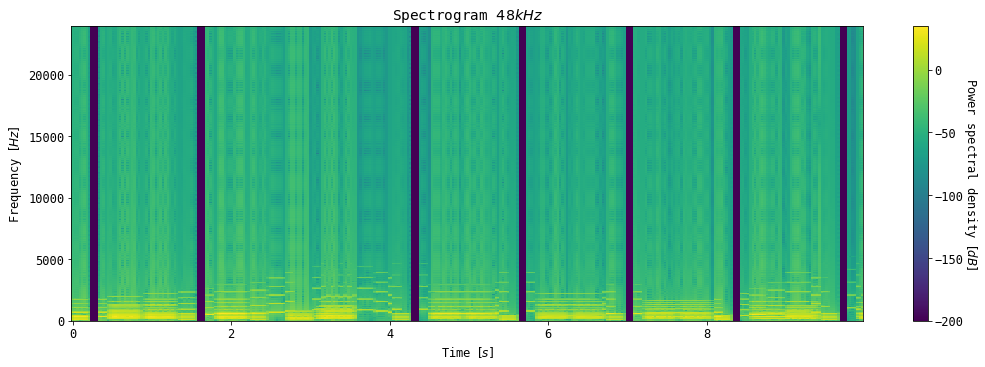

In [79]:
# Spectrogram 48kHz
N = 0.03 * 48000
Nfft = 2048
overlap = 0 
shift = N - overlap

X = spectrogram(out_48k[:10*48000], N, overlap, Nfft)
show_spectrogram(X, 48000, Nfft, shift)
plt.title('Spectrogram $48kHz$')
plt.show()

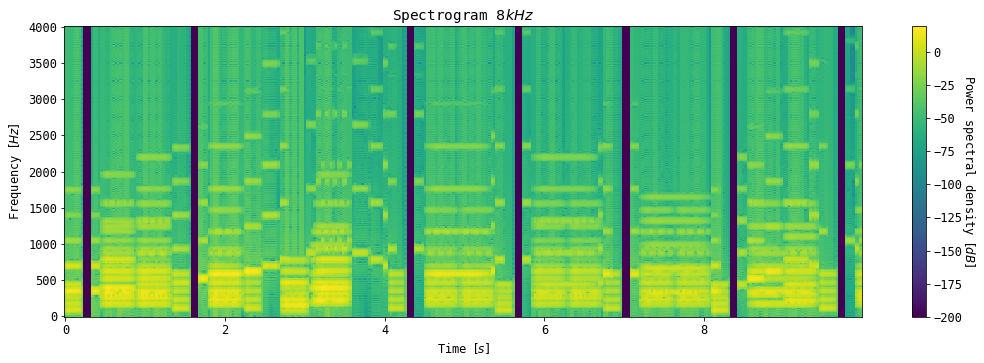

In [80]:
# Spectrogram 8kHz
N = 0.03 * 8000
Nfft = 512
overlap = 0 
shift = N - overlap 

X = spectrogram(out_8k[:10*8000], N, overlap, Nfft)
show_spectrogram(X, 8000, Nfft, shift)
plt.title('Spectrogram $8kHz$')
plt.show()